## NFL First & Future- Impact Detection.

For this competition, The data that we’ll use are from NFL 1st and Future - Impact Detection competition. We are tasked with identifying helmet collison from video files. The training set videos are in train with corresponding labels in train_labels.csv, while the videos for which we must predict are in the test folder. We’re also provided with files to aid in helmet detection. The images are in the images folder while the bounding boxes are on the image_label.csv.

In [1]:
## importing the dataset;
!pip install -q kaggle 
from google.colab import files
files.upload()
!mkdir ~/.kaggle

Saving kaggle.json to kaggle.json


In [2]:
mv ./kaggle.json /root/.kaggle/kaggle.json

In [ ]:
!pip install kaggle
!kaggle -v

In [4]:
%ls /root/.kaggle/

kaggle.json


In [5]:
!chmod 600 /root/.kaggle/kaggle.json

In [ ]:
!kaggle competitions files -c nfl-impact-detection

In [ ]:
!kaggle competitions download  -c nfl-impact-detection -p /content/kaggle/nfl
!unzip /content/kaggle/nfl/nfl-impact-detection.zip -d /content/kaggle/nfl/

**Libraries that Might Prove Useful**

In [7]:
import jax.numpy as jnp

from jax import grad, jit, vmap, pmap

from jax import lax

from jax import make_jaxpr
from jax import random
from jax import device_put
import imageio
from PIL import Image
import cv2
import numpy as np 
import pandas as pd 
import os
import subprocess
import matplotlib.pyplot as plt
import matplotlib.patches as patches
%matplotlib inline
plt.rcParams['figure.dpi'] = 150


from IPython.display import HTML
from base64 import b64encode
import warnings
warnings.filterwarnings('ignore') 

In [8]:
##all of our datasets and  their path
images_location = '/content/kaggle/nfl/images'
nflimpact_location = '/content/kaggle/nfl/nflimpact'
test_location = '/content/kaggle/nfl/test'
train_location = '/content/kaggle/nfl/train'
DATA_PATH = '/content/kaggle/nfl'


**First Let's check how visible the helmets are.**

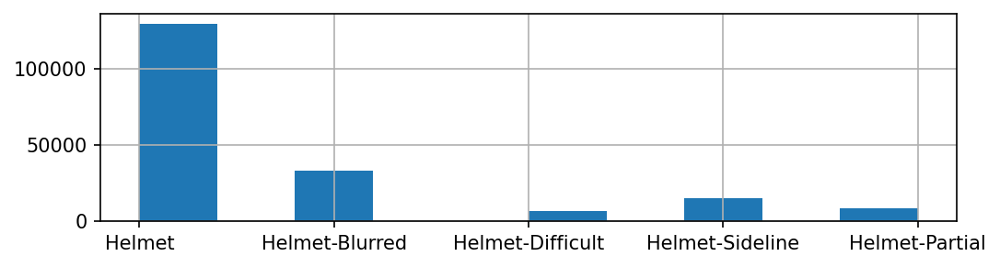

In [14]:
img_labels_df = pd.read_csv(DATA_PATH + '/image_labels.csv')
plt.figure(figsize = (8,2))
img_labels_df.label.hist()


**This is pretty fair**

**Now let's make a Function to Display Video**

In [ ]:
def show_video(video_path, video_width = 600):
   
  video_file = open(video_path, "r+b").read()
 
  video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"
  return HTML(f"""<video width={video_width} controls><source src="{video_url}"></video>""")


**This function will add the bounding boxes to every frame in our video**

In [ ]:

def annotate_video(video_path: str, video_labels: pd.DataFrame) -> str:
    VIDEO_CODEC = "MP4V"
    HELMET_COLOR = (0, 0, 0)    # Black
    IMPACT_COLOR = (0, 0, 255)  # Red
    video_name = os.path.basename(video_path)
    
    vidcap = cv2.VideoCapture(video_path)
    fps = vidcap.get(cv2.CAP_PROP_FPS)
    width = int(vidcap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(vidcap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    output_path = "labeled_" + video_name
    tmp_output_path = "tmp_" + output_path
    output_video = cv2.VideoWriter(tmp_output_path, cv2.VideoWriter_fourcc(*VIDEO_CODEC), fps, (width, height))
    frame = 0
    while True:
        it_worked, img = vidcap.read()
        if not it_worked:
            break
        
        # We need to add 1 to the frame count to match the label frame index that starts at 1
        frame += 1

        # Now, add the boxes
        boxes = video_labels.query("video == @video_name and frame == @frame")
        for box in boxes.itertuples(index=False):
            if box.impact == 1 and box.confidence > 1 and box.visibility > 0:    # Filter for definitive head impacts and turn labels red
                color, thickness = IMPACT_COLOR, 4
            else:
                color, thickness = HELMET_COLOR, 2
            # Add a box around the helmet
            cv2.rectangle(img, (box.left, box.top), (box.left + box.width, box.top + box.height), color, thickness=thickness)
        output_video.write(img)
    output_video.release()
    
    # Not all browsers support the codec, we will re-load the file at tmp_output_path and convert to a codec that is more broadly readable using ffmpeg
    if os.path.exists(output_path):
        os.remove(output_path)
    subprocess.run(["ffmpeg", "-i", tmp_output_path, "-crf", "18", "-preset", "veryfast", "-vcodec", "libx264", output_path])
    os.remove(tmp_output_path)
    
    return output_path

### Our Image Data

In [ ]:
#This is how we'll import the Data
Image_Labels = pd.read_csv('/content/kaggle/nfl/image_labels.csv')
Image_Labels.head()

,image,label,left,width,top,height
0,57503_000116_Endzone_frame443.jpg,Helmet,1099,16,456,15
1,57503_000116_Endzone_frame443.jpg,Helmet,1117,15,478,16
2,57503_000116_Endzone_frame443.jpg,Helmet,828,16,511,15
3,57503_000116_Endzone_frame443.jpg,Helmet,746,16,519,16
4,57503_000116_Endzone_frame443.jpg,Helmet,678,17,554,17


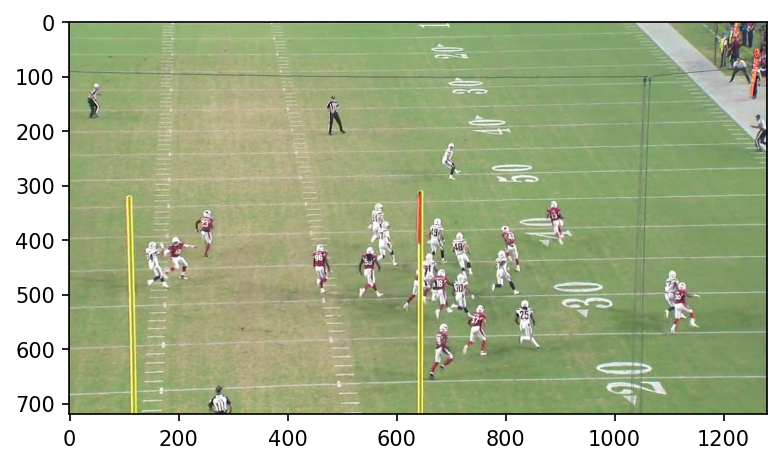

In [ ]:
#We'll pick a random image and add the labels.
Image_Name = Image_Labels['image'][0]

img_path = f"kaggle/nfl/images/{Image_Name}"
img = imageio.imread(img_path)
plt.imshow(img)
plt.show()


**function to add bounding images from the label to the image.**

In [ ]:
# Function to add labels to an Image
def add_img_box(image_name, image_labels):
  
    boxes = Image_Labels.loc[Image_Labels['image'] == Image_Name]
    for i, box in boxes.iterrows():
    
        # Add a box around the helmet
        # Note that cv2.rectangle needs us to specify the top left pixel and the bottom right pixel
        cv2.rectangle(img, (box.left, box.top), (box.left + box.width, box.top + box.height), (255, 60, 60), thickness=1)
        #display the image with Bounding Boxes
        plt.imshow(img)
        ##plt.show()
    plt.show()
        

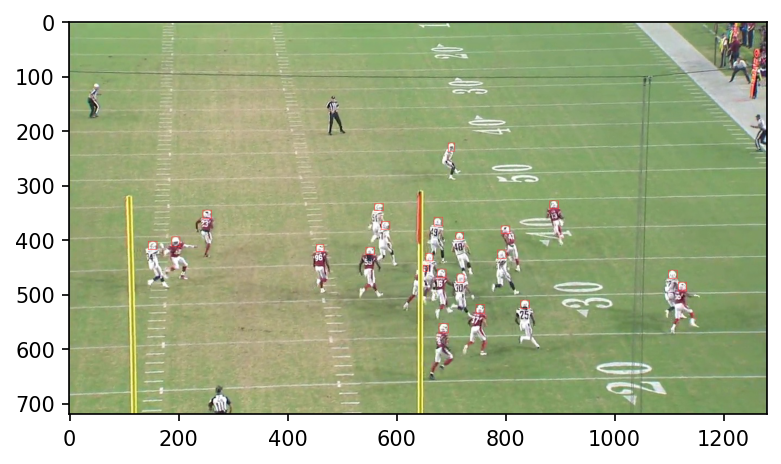

In [ ]:
add_img_box(Image_Name, Image_Labels)

**This allows us to see the bounding box around an image.**

**This is our video Data**

Each play has a sideline view and an endzone view.

In [ ]:

video_labels = pd.read_csv('/content/kaggle/nfl/train_labels.csv')
video_labels.head()

,gameKey,playID,view,video,frame,label,left,width,top,height,impact,impactType,confidence,visibility
0,57583,82,Endzone,57583_000082_Endzone.mp4,1,H30,629,19,40,24,NaN,NaN,NaN,NaN
1,57583,82,Endzone,57583_000082_Endzone.mp4,1,V72,443,22,344,16,NaN,NaN,NaN,NaN
2,57583,82,Endzone,57583_000082_Endzone.mp4,1,V86,871,21,359,17,NaN,NaN,NaN,NaN
3,57583,82,Endzone,57583_000082_Endzone.mp4,1,V74,771,19,345,15,NaN,NaN,NaN,NaN
4,57583,82,Endzone,57583_000082_Endzone.mp4,1,V34,549,26,461,20,NaN,NaN,NaN,NaN




**This is the evaluation criteria** 

• impact = 1

• confidence > 1

• visibility > 0

Those labels with confidence = 1 document cases in which human labelers asserted it was possible that a helmet impact occurred, but it was not clear that the helmet impact altered the trajectory of the helmet. Those labels with visibility = 0 indicate that although there is reason to believe that an impact occurred to that helmet at that time, the impact itself was not visible from the view.

**Let's look at one of our videos**


In [ ]:
video_name = video_labels['video'][100]

video_path = f"kaggle/nfl/train/{video_name}" 

show_video(video_path)

**Lets make a function to annotate our video**

In [ ]:
## we can use our annotate_video that we have build earlier and annotate it . 
labeled_video = annotate_video(f"kaggle/nfl/train/{video_name}", video_labels)
show_video(labeled_video)

**Look for the definitve impacts in this video**

In [ ]:

video_impacts = video_labels.loc[(video_labels.video == video_name) & (video_labels.impact == 1) & (video_labels.confidence > 1) & (video_labels.visibility > 0)]
len(video_impacts)

19

In [ ]:
# Here's the list of definitive impacts
video_impacts

,gameKey,playID,view,video,frame,label,left,width,top,height,impact,impactType,confidence,visibility
746,57583,82,Endzone,57583_000082_Endzone.mp4,38,H99,582,21,311,27,1.0,Helmet,2.0,2.0
754,57583,82,Endzone,57583_000082_Endzone.mp4,38,V68,562,18,313,15,1.0,Helmet,2.0,2.0
967,57583,82,Endzone,57583_000082_Endzone.mp4,49,H97,425,15,311,20,1.0,Helmet,3.0,3.0
969,57583,82,Endzone,57583_000082_Endzone.mp4,49,V72,434,18,316,15,1.0,Helmet,3.0,3.0
1007,57583,82,Endzone,57583_000082_Endzone.mp4,51,V73,614,19,317,14,1.0,Shoulder,3.0,3.0
1149,57583,82,Endzone,57583_000082_Endzone.mp4,58,H90,238,18,299,31,1.0,Helmet,3.0,3.0
1156,57583,82,Endzone,57583_000082_Endzone.mp4,58,V79,252,19,315,13,1.0,Helmet,3.0,3.0
1504,57583,82,Endzone,57583_000082_Endzone.mp4,76,V15,1007,20,291,23,1.0,Helmet,2.0,3.0
1511,57583,82,Endzone,57583_000082_Endzone.mp4,76,H59,1001,13,289,15,1.0,Helmet,2.0,3.0
1625,57583,82,Endzone,57583_000082_Endzone.mp4,82,V86,856,16,304,14,1.0,Helmet,3.0,3.0


**Now we'll do the samething for the other view of the play**

In [ ]:
sideline_video_name = video_name.replace("Endzone", "Sideline")


sideline_video_path = f"kaggle/nfl/train/{sideline_video_name}"
labeled_video = annotate_video(sideline_video_path, video_labels)
show_video(labeled_video)